# MODULES

In [4]:
!pip install plotly
!pip install pathlib
!pip install matplotlib
!pip install jupyterlab "ipywidgets>=7.6" "plotly>=5.0.0"

In [5]:
!nvidia-smi

Sat Sep 13 14:46:23 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 570.169                Driver Version: 570.169        CUDA Version: 12.8     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce MX330           Off |   00000000:2C:00.0 Off |                  N/A |
| N/A   48C    P8            N/A  / 5001W |       5MiB /   2048MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [6]:
import torch
print(torch.__version__)
print(torch.version.cuda)
print(torch.cuda.get_device_name(0))
import os
import cv2
import math
import pathlib
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

1.13.1+cu117
11.7
NVIDIA GeForce MX330


# GLOBAL VARIABLES

In [7]:
ROOT_DIR_IMAGES = '../SampleSet/MVS Data/scan6_2'

# CAMERA

In [8]:
class SimplePinholeCamera:
    def __init__(self, f=None, cx=None, cy=None):
        self.f = f
        self.cx = cx
        self.cy = cy

    def K(self):
        """Return intrinsic calibration matrix."""
        return np.array([
            [self.f,    0, self.cx],
            [0,    self.f, self.cy],
            [0,        0,       1]
        ], dtype=np.float64)

    def __repr__(self):
        return f"<SimplePinholeCamera f={self.f:.2f}, cx={self.cx:.2f}, cy={self.cy:.2f}>"

# IMAGES

In [9]:
class ImageMisc:
    @classmethod
    def get_paths(cls, root_dir, filter):
        paths = []
        for path in pathlib.Path(root_dir).glob(filter):
            paths.append(str(path))
        paths = sorted(paths)
        return paths
    
    @classmethod
    def load_images(cls, paths):
        images = []
        for path in paths:
            img_bgr = cv2.imread(path)          # Load as BGR
            if img_bgr is None:
                continue  # skip if image not found or unreadable
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)  # Convert to RGB
            images.append(img_rgb)
        return images

    @classmethod
    def to_grayscale(cls, image):
        if image.ndim == 2:  # already grayscale
            return image
        else:  # RGB to grayscale
            gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
            return gray

In [10]:
class SuperImage:
    def __init__(self):
        self.imag_color = None
        self.imag_gray = None
        self.keypoints = None
        self.descripts = None
        
    def set_imag_color(self, imag_color):
        self.imag_color = imag_color
        return self

    def set_imag_gray(self, imag_gray):
        self.imag_gray = imag_gray
        return self

    def set_keypoints(self, keypoints):
        self.keypoints = keypoints
        return self

    def set_descriptors(self, descripts):
        self.descripts = descripts
        return self

    def imag_w_keypoints(self, circle_color=(0, 255, 0), circle_thickness=2, line_thickness=2):
        imag = self.imag_color.copy()

        for kpt in self.keypoints:
            x, y = int(kpt.pt[0]), int(kpt.pt[1])
            radius = int(kpt.size / 2)
    
            # Draw circle
            cv2.circle(imag, (x, y), radius, circle_color, thickness=circle_thickness)
    
            # Draw orientation line
            angle_rad = math.radians(kpt.angle)
            x2 = int(x + radius * math.cos(angle_rad))
            y2 = int(y + radius * math.sin(angle_rad))
            cv2.line(imag, (x, y), (x2, y2), circle_color, thickness=line_thickness)
    
        return imag

In [31]:
class SuperImagePair():
    def __init__(self, simga1, simga2):
        self.simag1 = simga1
        self.simag2 = simga2
        
        self.K = None
        self.matcher = None
        
        self.matches = None
        self.matches_good = None
        self.matches_inlier = None
        
        self.F = None
        self.E = None
        self.R = None
        self.t = None

    
    def set_intrinsic(self, K):
        self.K = K

    
    def set_matcher(self, matcher):
        self.matcher = matcher

    
    def match(self, ratio_thresh=0.75):    
        if self.matcher is None:
            print('Matcher must be set.')
            return     
    
        dess1 = self.simag1.descripts
        dess2 = self.simag2.descripts
    
        # --- Check if descriptors exist ---
        if dess1 is None or dess2 is None:
            print("Descriptors are missing.")
            return
        if len(dess1) == 0 or len(dess2) == 0:
            print("Empty descriptors.")
            return
    
        # --- Ensure correct dtype ---
        if dess1.dtype != np.float32 and dess1.dtype != np.uint8:
            dess1 = dess1.astype(np.float32)
        if dess2.dtype != np.float32 and dess2.dtype != np.uint8:
            dess2 = dess2.astype(np.float32)
    
        # --- Perform matching ---
        matches = self.matcher.knnMatch(dess1, dess2, k=2)
        matches_good = []
        
        for pair in matches:
            if len(pair) < 2:  # sometimes only 1 match is found
                continue
            m, n = pair
            if m.distance < ratio_thresh * n.distance:
                matches_good.append(m)
    
        self.matches = matches
        self.matches_good = matches_good
    
        print(f"Found {len(matches_good)} good matches (out of {len(matches)} total).")

        
    def estimate_fundamental_matrix(self, ransacReprojThreshold, confidence):
        good_matches = self.matches_good
        kpts1 = self.simag1.keypoints
        kpts2 = self.simag2.keypoints
        
        if good_matches is None:
            print('Must run "match" method first.')
            return
        
        if len(good_matches) >= 8:  # minimum for 8-point algorithm
            pts1 = np.float32([kpts1[m.queryIdx].pt for m in good_matches])
            pts2 = np.float32([kpts2[m.trainIdx].pt for m in good_matches])
        
            F, mask = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC, ransacReprojThreshold, confidence)
            
            if F is None:
                print("Fundamental matrix not found.")
                return

            # Enforce rank 2
            U, S, Vt = np.linalg.svd(F)
            S[2] = 0
            F = U @ np.diag(S) @ Vt
            
            inlier_count = int(mask.sum())
            ratio = inlier_count / len(good_matches)
            
            print("Good matches: {:06d}, Inlier matches (RANSAC): {:06d}, Ratio: {:.6f}".format(
                len(good_matches), inlier_count, ratio))
            
            print("Fundamental matrix F:")
            for row in F:
                formatted_row = ["{:13.6e}".format(val) for val in row]
                print("  [" + " ".join(formatted_row) + "]")
            
            inlier_matches = [gm for gm, m in zip(good_matches, mask.ravel()) if m == 1]
            
            self.F = F
            self.matches_inlier = inlier_matches  # keep naming consistent
        
        else:
            print("Not enough good matches to estimate F.")

    
    def estimate_essential_matrix(self):
        if self.F is None:
            print("Fundamental matrix must be estimated first.")
            return None
        if self.K is None:
            print("Camera intrinsics K not provided.")
            return None
    
        # Compute E
        self.E = self.K.T @ self.F @ self.K
    
        # Enforce rank-2 constraint
        U, S, Vt = np.linalg.svd(self.E)
        S[2] = 0
        self.E = U @ np.diag(S) @ Vt
    
        # Print nicely
        print("Essential matrix E:")
        for row in self.E:
            formatted_row = ["{:13.6e}".format(val) for val in row]
            print("  [" + " ".join(formatted_row) + "]")

    # def estimate_pose(self):
    #     if self.E is None:
    #         print("Essential matrix must be estimated first.")
    #         return None, None
    #     if self.inlier_matches is None:
    #         print("Need inlier matches from F estimation.")
    #         return None, None

    #     kpts1 = self.simag1.kpts
    #     kpts2 = self.simag2.kpts
    #     pts1 = np.float32([kpts1[m.queryIdx].pt for m in self.inlier_matches])
    #     pts2 = np.float32([kpts2[m.trainIdx].pt for m in self.inlier_matches])

    #     _, R, t, mask = cv2.recoverPose(self.E, pts1, pts2, self.K)
    #     self.R = R
    #     self.t = t

    #     print("Recovered Pose:")
    #     print("Rotation R:\n", R)
    #     print("Translation t:\n", t.ravel())

    # ---- all your other methods remain unchanged ----
    def imag_w_matches(self, kind, max_matches=0):
        if kind == 'good-matches':
            matches = self.matches_good
        elif kind == 'inlier-matches':
            matches = self.matches_inlier
        else:
            print('match_kind in {good-matches, inlier-matches}')
        
        imag1 = self.simag1.imag_color
        kpts1 = self.simag1.keypoints
        
        imag2 = self.simag2.imag_color
        kpts2 = self.simag2.keypoints

        if max_matches:
            matches = matches[:max_matches]
            
        imag = cv2.drawMatches(
            imag1, kpts1,
            imag2, kpts2,
            matches, None,
            flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
        )
        return imag

    
    def imag_w_epipolar(self, num_points=40, scale=1.5, point_size=12):
        """
        Return two images:
        - Image 1: with epipolar lines (from points in image2) + keypoints
        - Image 2: with epipolar lines (from points in image1) + keypoints
        """
        if self.F is None:
            print("You must estimate the fundamental matrix first.")
            return None, None
        
        if self.matches_inlier is None or len(self.matches_inlier) == 0:
            print("No inlier matches found. Run estimate_fundamental_matrix() first.")
            return None, None
        
        imag1 = self.simag1.imag_color.copy()
        imag2 = self.simag2.imag_color.copy()
        kpts1 = self.simag1.keypoints
        kpts2 = self.simag2.keypoints
        
        # pick subset of inlier matches
        np.random.seed(0)
        matches_drawn = np.random.choice(
            self.matches_inlier,
            size=min(num_points, len(self.matches_inlier)),
            replace=False
        )
        
        pts1 = np.float32([kpts1[m.queryIdx].pt for m in matches_drawn])
        pts2 = np.float32([kpts2[m.trainIdx].pt for m in matches_drawn])
        
        # ---- Assign a color per match and reuse it ----
        colors = [tuple(np.random.randint(0,255,3).tolist()) for _ in range(len(matches_drawn))]
        
        # ---- Lines in image 2 (from points in image1) ----
        lines2 = cv2.computeCorrespondEpilines(pts1.reshape(-1,1,2), 1, self.F).reshape(-1,3)
        for (x1, y1), (a, b, c), color in zip(pts1, lines2, colors):
            cv2.circle(imag1, (int(x1), int(y1)), point_size, color, -1)   # larger point in image1
            x0, y0 = 0, int(-c/b) if abs(b) > 1e-6 else 0
            x1l, y1l = imag2.shape[1], int(-(c + a*imag2.shape[1])/b) if abs(b) > 1e-6 else imag2.shape[0]
            cv2.line(imag2, (x0,y0), (x1l,y1l), color, 2)                 # epipolar line in image2
    
        # ---- Lines in image 1 (from points in image2) ----
        lines1 = cv2.computeCorrespondEpilines(pts2.reshape(-1,1,2), 2, self.F).reshape(-1,3)
        for (x2, y2), (a, b, c), color in zip(pts2, lines1, colors):
            cv2.circle(imag2, (int(x2), int(y2)), point_size, color, -1)   # larger point in image2
            x0, y0 = 0, int(-c/b) if abs(b) > 1e-6 else 0
            x1l, y1l = imag1.shape[1], int(-(c + a*imag1.shape[1])/b) if abs(b) > 1e-6 else imag1.shape[0]
            cv2.line(imag1, (x0,y0), (x1l,y1l), color, 2)                  # epipolar line in image1
    
        # ---- Resize images to see lines better ----
        if scale != 1.0:
            imag1 = cv2.resize(imag1, None, fx=scale, fy=scale, interpolation=cv2.INTER_LINEAR)
            imag2 = cv2.resize(imag2, None, fx=scale, fy=scale, interpolation=cv2.INTER_LINEAR)
    
        return imag1, imag2


    def evaluate_fundamental_estimation_quality(self):
        if self.F is None or self.matches_inlier is None:
            print("Fundamental matrix not estimated yet.")
            return None
    
        kpts1 = self.simag1.keypoints
        kpts2 = self.simag2.keypoints
    
        pts1 = np.float32([kpts1[m.queryIdx].pt for m in self.matches_inlier])
        pts2 = np.float32([kpts2[m.trainIdx].pt for m in self.matches_inlier])
    
        pts1_h = np.hstack([pts1, np.ones((pts1.shape[0], 1))])
        pts2_h = np.hstack([pts2, np.ones((pts2.shape[0], 1))])
    
        F = self.F
    
        algebraic = []
        sampson = []
        sym_epi = []
    
        for p1, p2 in zip(pts1_h, pts2_h):
            # Algebraic error
            err = abs(p2 @ F @ p1)
            algebraic.append(err)
    
            # Sampson distance
            Fx1 = F @ p1
            Ftx2 = F.T @ p2
            denom = Fx1[0]**2 + Fx1[1]**2 + Ftx2[0]**2 + Ftx2[1]**2
            if denom > 1e-12:
                sampson.append((err**2) / denom)
    
            # Symmetric epipolar distance
            l2 = Fx1  # epipolar line in image2
            l1 = Ftx2 # epipolar line in image1
            d2 = abs(p2 @ l2) / np.sqrt(l2[0]**2 + l2[1]**2 + 1e-12)
            d1 = abs(p1 @ l1) / np.sqrt(l1[0]**2 + l1[1]**2 + 1e-12)
            sym_epi.append(0.5*(d1 + d2))
    
        # Rank-2 check
        _, svals, _ = np.linalg.svd(F)
    
        results = {
            "mean_algebraic": np.mean(algebraic),
            "mean_sampson": np.mean(sampson),
            "median_sampson": np.median(sampson),
            "mean_symmetric_epipolar": np.mean(sym_epi),
            "median_symmetric_epipolar": np.median(sym_epi),
            "rank": int(np.sum(svals > 1e-12)),
            "singular_values": svals.tolist(),
            "n_inliers": len(algebraic)
        }
    
        for k, v in results.items():
            print(f"{k}: {v}")
    
        # return results

In [32]:
class Plot:
    @classmethod    
    def plot_images_grid(cls, images, nrows=1, ncols=1, figsize=(12, 8)):
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
        
        # Make axes iterable, whether it's 1 Axes or an array
        if nrows * ncols == 1:
            axes = [axes]
        else:
            axes = axes.flatten()

        for ax, img in zip(axes, images):
            if img.ndim == 2:  # grayscale
                ax.imshow(img, cmap="gray")
            else:  # RGB
                ax.imshow(img)
            ax.axis("off")

        for ax in axes[len(images):]:
            ax.axis("off")

        plt.tight_layout()
        plt.show()

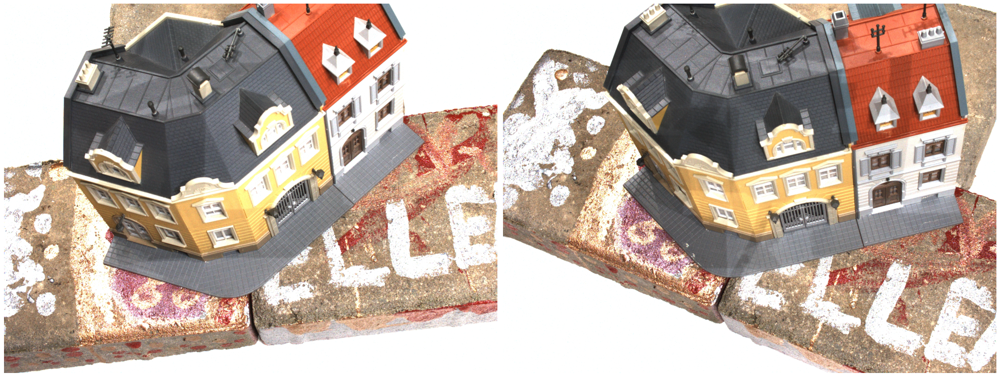

In [33]:
paths = ImageMisc.get_paths(ROOT_DIR_IMAGES, '*max.png')
imags_color = ImageMisc.load_images(paths)
Plot.plot_images_grid(imags_color, 1,2, (25,10))

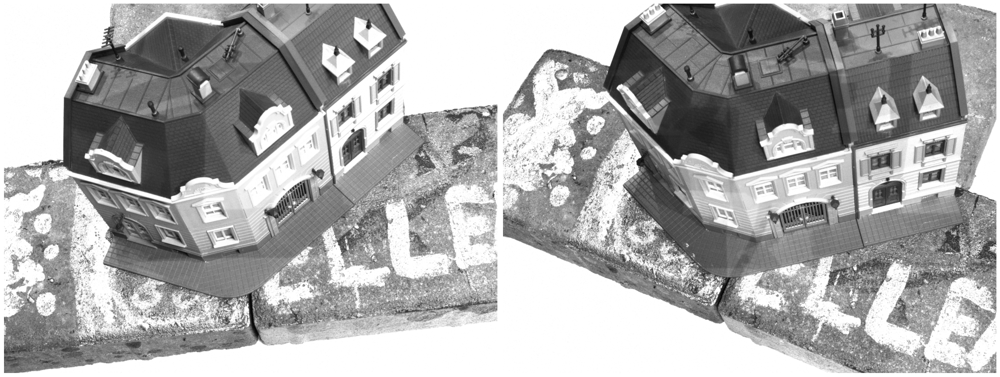

In [34]:
imags_gray = list(map(ImageMisc.to_grayscale, imags_color))
Plot.plot_images_grid(imags_gray, 1,2, (25,10))

# FEATURE DETECTOR

In [35]:
class FeatureDetector:
  def __init__(self, kind):
      allowed = ['sift', 'orb']
      if kind not in allowed:
        raise ValueError(f"Unsupported feature detector: {kind}. Allowed: {allowed}")

      if kind == 'sift':
        self.detector = cv2.SIFT_create()
      elif kind == 'orb':
        self.detector = cv2.ORB_create()


  def detect(self, image_gray):
      kpts, dess = self.detector.detectAndCompute(image_gray, None)
      return kpts, dess

In [36]:
FD = FeatureDetector(kind='sift')
SUPERIMAGES = []
for imag_color, imag_gray in zip(imags_color, imags_gray):
    keypoints, descriptors = FD.detect(imag_gray)
    si = SuperImage()
    si.set_imag_color(imag_color)
    si.set_imag_gray(imag_gray)
    si.set_keypoints(keypoints)
    si.set_descriptors(descriptors)
    SUPERIMAGES.append(si)

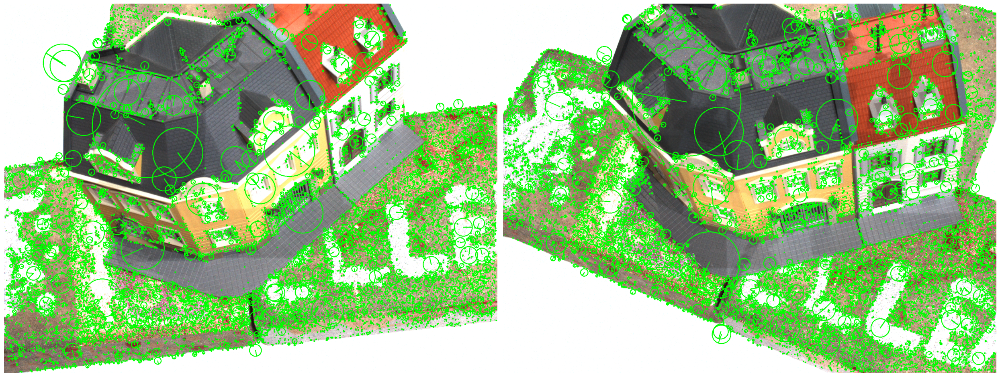

In [37]:
imags_w_keypoints = [si.imag_w_keypoints() for si in SUPERIMAGES]
Plot.plot_images_grid(imags_w_keypoints, 1,2, (25,10))

In [38]:
si1 = SUPERIMAGES[0]
si2 = SUPERIMAGES[1] 

sip = SuperImagePair(si1, si2)

sip.set_matcher(
    cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
)
sip.match()

Found 2223 good matches (out of 16939 total).


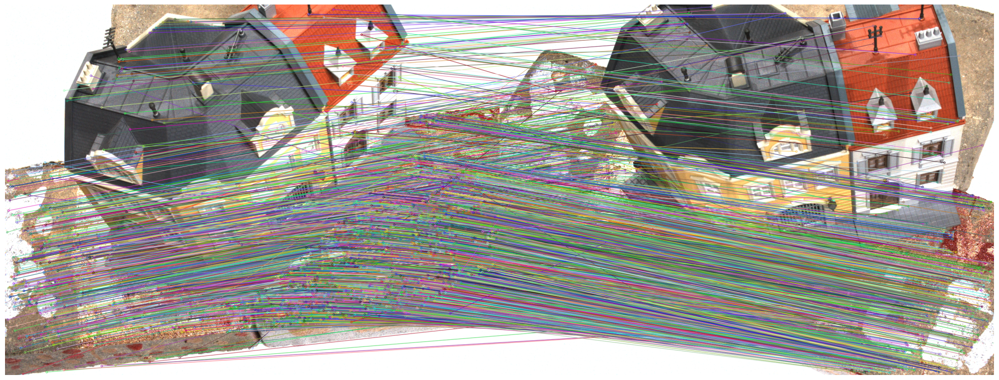

In [39]:
imag_w_matches = sip.imag_w_matches(kind='good-matches')
Plot.plot_images_grid([imag_w_matches], 1,1, (20,10))

In [54]:
sip.estimate_fundamental_matrix(ransacReprojThreshold=0.25, confidence=0.99)
sip.evaluate_fundamental_estimation_quality()

Good matches: 002223, Inlier matches (RANSAC): 001117, Ratio: 0.502474
Fundamental matrix F:
  [ 2.980796e-07  5.931070e-07 -5.995009e-04]
  [-6.854927e-07  4.228457e-07  2.285588e-03]
  [-7.654326e-04 -2.585846e-03  1.000000e+00]
mean_algebraic: 0.00022558521774296978
mean_sampson: 0.00922620935940046
median_sampson: 0.006047507191651418
mean_symmetric_epipolar: 0.11523593459616745
median_symmetric_epipolar: 0.1099775934253015
rank: 2
singular_values: [1.000006427859786, 6.494661054335869e-06, 5.3030806666089074e-20]
n_inliers: 1117


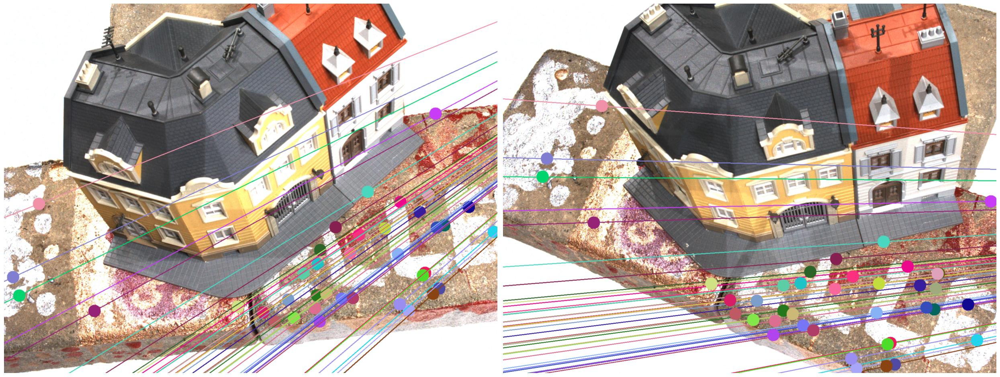

In [55]:
imag1_epipolar, imag2_epipolar = sip.imag_w_epipolar(num_points=40, scale=2.5, point_size=20)
Plot.plot_images_grid([imag1_epipolar, imag2_epipolar], 1,2, (25,10))

# IMAGES PAIRS

In [60]:
SIMAGPs = []
for simag1, simag2 in zip(SIMAGs[:-1], SIMAGs[1:]):
    simagp = SuperImagePair(simag1, simag2, CAMERA.K())
    SIMAGPs.append(simagp)

NameError: name 'SIMAGs' is not defined

## Match points

In [ ]:
imag_matchs = []
imag_inliers = []
imag_epipolars = []
fund_qualities = []
for simagp in SIMAGPs:
    simagp.match(kind='brute-force')
    
    simagp.estimate_fundamental_matrix()

    simagp.estimate_essential_matrix()

    simagp.estimate_pose()
    
    fund_qualities.append(
        simagp.evaluate_fundamental_quality()
    )

    imag_matchs.append(
        simagp.generate_imag_with_matches(match_kind='good-matches')
    )
    imag_inliers.append(
        simagp.generate_imag_with_matches(match_kind='inlier-matches')
    )
    imag_epipolars.append(
        simagp.generate_imag_with_epilines(max_epipolars=100)
    )

In [ ]:
Plot.plot_images_grid(imag_matchs, 1,2, (20,5))

In [ ]:
Plot.plot_images_grid(imag_inliers, 1,2, (20,5))

In [ ]:
imag_epipolars_1, imag_epipolars_2 = list(zip(*imag_epipolars))

In [ ]:
Plot.plot_images_grid(imag_epipolars_1, 1,2, (20,5))

In [ ]:
Plot.plot_images_grid(imag_epipolars_2, 1,2, (20,5))

In [ ]:
class CalibratedSfM:
    def __init__(self, super_image_pairs, K):
        """
        super_image_pairs: list of SuperImagePair objects, consecutive pairs
        K: intrinsic camera matrix (same for all images)
        """
        assert len(super_image_pairs) >= 1, "Need at least one image pair"
        self.pairs = super_image_pairs
        self.K = K
        self.num_images = len(super_image_pairs) + 1  # N images, N-1 pairs
        self.Ps = []  # list of 3x4 projection matrices
        self.points_3d = None

    def _build_projection_matrices(self):
        """Build camera projection matrices from R, t and K."""
        self.Ps = []
        # First camera is canonical
        first_pair = self.pairs[0]
        R0 = np.eye(3)
        t0 = np.zeros(3)
        self.Ps.append(self.K @ np.hstack([R0, t0.reshape(3,1)]))

        # Other cameras from SuperImagePair poses
        for i, pair in enumerate(self.pairs):
            R, t = pair.R, pair.t
            P = self.K @ np.hstack([R, t.reshape(3,1)])
            # Avoid duplicating first camera
            if i == 0:
                self.Ps.append(P)
            else:
                self.Ps.append(P)

    def _triangulate_pair(self, P1, P2, pair):
        """Triangulate points from a SuperImagePair object."""
        pts1 = np.float32([pair.simag1.kpts[m.queryIdx].pt for m in pair.inlier_matches]).T
        pts2 = np.float32([pair.simag2.kpts[m.trainIdx].pt for m in pair.inlier_matches]).T

        points_4d = cv2.triangulatePoints(P1, P2, pts1, pts2)
        points_3d = (points_4d[:3] / points_4d[3]).T
        return points_3d

    def run(self):
        """Run calibrated SfM over all pairs and return camera matrices and 3D points."""
        self._build_projection_matrices()
        all_points = []

        for i, pair in enumerate(self.pairs):
            P1 = self.Ps[i]
            P2 = self.Ps[i+1]
            points_3d = self._triangulate_pair(P1, P2, pair)
            all_points.append(points_3d)

        if all_points:
            self.points_3d = np.vstack(all_points)
        else:
            self.points_3d = np.zeros((0,3))

        return self.Ps, self.points_3d

In [ ]:
def remove_points_behind_cameras(points_3d, Ps):
    """Remove points that are behind any camera."""
    filtered_points = []
    for X in points_3d:
        in_front = True
        for P in Ps:
            R = P[:, :3]
            t = P[:, 3]
            X_cam = R @ X + t
            if X_cam[2] <= 0:  # Z <= 0 => behind camera
                in_front = False
                break
        if in_front:
            filtered_points.append(X)
    return np.array(filtered_points)

In [ ]:
sfm = CalibratedSfM(SIMAGPs, CAMERA.K())
cameras, points_3d = sfm.run()
points_3d = remove_points_behind_cameras(points_3d, cameras)

In [ ]:
def remove_distant_points(points_3d, max_distance_ratio=1.0):
    """
    Remove points that are too far from the centroid.
    
    points_3d: Nx3 array of 3D points
    max_distance_ratio: points farther than max_distance_ratio * std will be removed
    """
    if points_3d.shape[0] == 0:
        return points_3d

    centroid = points_3d.mean(axis=0)
    distances = np.linalg.norm(points_3d - centroid, axis=1)
    std_distance = distances.std()
    mask = distances <= max_distance_ratio * std_distance
    filtered_points = points_3d[mask]
    return filtered_points

In [ ]:
points_3d = remove_distant_points(points_3d,  max_distance_ratio=10.0)

In [ ]:
import plotly.graph_objects as go
import numpy as np

def plot_sfm_interactive(Ps, points_3d):
    """
    Ps: list of camera projection matrices (3x4)
    points_3d: Nx3 array of 3D points
    """
    # 3D points trace
    pts_trace = go.Scatter3d(
        x=points_3d[:, 0],
        y=points_3d[:, 1],
        z=points_3d[:, 2],
        mode='markers',
        marker=dict(size=3, color='blue'),
        name='Points'
    )

    # Cameras trace
    cam_x, cam_y, cam_z = [], [], []
    cam_labels = []
    for i, P in enumerate(Ps):
        M = P[:, :3]
        p4 = P[:, 3]
        # Camera center in world coordinates
        C = -np.linalg.inv(M) @ p4
        cam_x.append(C[0])
        cam_y.append(C[1])
        cam_z.append(C[2])
        cam_labels.append(f'Cam {i}')

    cam_trace = go.Scatter3d(
        x=cam_x,
        y=cam_y,
        z=cam_z,
        mode='markers+text',
        marker=dict(size=5, color='red', symbol='diamond'),
        text=cam_labels,
        textposition='top center',
        name='Cameras'
    )

    fig = go.Figure(data=[pts_trace, cam_trace])
    fig.update_layout(
        scene=dict(
            xaxis=dict(title='X'),
            yaxis=dict(title='Y'),
            zaxis=dict(title='Z'),
            aspectmode='data'  # keeps scale equal
        ),
        width=1200,
        height=1200
    )

    fig.show()

In [ ]:
plot_sfm_interactive(cameras, points_3d)